# business Problem

#### Objetivo do Problema
    -- Previsão do primeiro destino que um novo usuario irá escolher.

#### Porque?
**Qual tipo de modelo de negócio do AirBNB?**
    
    -- MarketPlace (Conecta pessoas que oferecem acomodação, com pessoas que estão procurando acomodação).

##### Oferta (Pessoas oferecendo acomodação)

    -- Tamanho do portfolio
    -- Diversidade/densidade de portfolio
    -- Preço medio

##### Demanda (Pessoas procurando acomodação)

    -- Numero de usuarios
    -- LTV (Lifitime Value)
    -- CAC (Client Acquisition Cost)

**Cross Revenue** (FEE * Numero Cliente) - CAC

#### Proposta da Solução

    -- Modelo de predição do primeiro destino de um novo usuario.

##### Tipos de formatos para entrega do projeto.
    -- Predições salva em tabela do banco de dados.
    -- API: Input: Usuario e suas caracteristicas / Output: Usuario e suas caracteristicas com as Predições do destino.

# Ciclo06: Exploratory_data_Analysis

# 00 - Imports

In [2]:
import pandas as pd
import random
import numpy as np
from scipy import stats

import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from sklearn import preprocessing as pp
from sklearn import metrics as m
from scikitplot import metrics as mt
from sklearn.preprocessing import RobustScaler
from category_encoders import TargetEncoder

from keras import models as ml
from keras import layers as l

import warnings
import pickle

warnings.filterwarnings('ignore')

from IPython.core.display import display, HTML
display(HTML(""))

2022-12-15 08:20:59.014010: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-12-15 08:20:59.622003: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2022-12-15 08:20:59.622017: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2022-12-15 08:20:59.694845: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2022-12-15 08:21:00.840280: W tensorflow/stream_executor/platform/de

## Functions

In [3]:
def drescriptive_statistical (df):

    num_atributes = df.copy()
    #Central Tendency - mean - median
    ct1 = pd.DataFrame(num_atributes.apply(np.mean)).T
    ct2 = pd.DataFrame(num_atributes.apply(np.median)).T

    #Dispersion - STD, min, max, range, sken, Kurtosis
    d1 = pd.DataFrame(num_atributes.apply(np.std)).T
    d2 = pd.DataFrame(num_atributes.apply(min)).T
    d3 = pd.DataFrame(num_atributes.apply(max)).T
    d4 = pd.DataFrame(num_atributes.apply(lambda x: x.max() - x.min() )).T
    d5 = pd.DataFrame(num_atributes.apply(lambda x: x.skew() )).T
    d6 = pd.DataFrame(num_atributes.apply(lambda x: x.kurtosis() )).T

    #Concatenate

    m = pd.concat([d2, d3, d4, ct1, ct2, d1, d5, d6]).T.reset_index()
    m.columns = ['attributes', 'min', 'max', 'range', 'mean', 'median', 'std', 'skew', 'kurtosis']
    return m


def jupyter_settings():
    %matplotlib inline
    plt.style.use( 'bmh' )
    plt.rcParams['figure.figsize'] = [25, 12]
    plt.rcParams['font.size'] = 24
    #display( HTML( '<style>.container { width:100% !important; }</style>') )
    pd.options.display.max_columns = None
    pd.options.display.max_rows = None
    pd.set_option( 'display.expand_frame_repr', False )
    sns.set()
    jupyter_settings()


#Function Calculates cramer V
def cramer_v(x, y):
    cm = pd.crosstab(x, y).values
    n = cm.sum()
    r, k = cm.shape
    
    chi2 = stats.chi2_contingency( cm )[0]
    chi2corr = max(0, chi2 - ( k - 1 ) * ( r - 1) / (n - 1))
    kcorr = k - (k - 1) **2/(n - 1) 
    rcorr = r - (r - 1) **2/(n - 1)
    
    return np.sqrt( (chi2corr / n) / (min(kcorr -1, rcorr -1) ) )

## Paths

In [4]:
path_data = '/home/wellington/Documentos/Projetos/Projetos_ds_pa/airbnb_predict_first_booking/airbnb_predict_first_booking/data/'
path_model = '/home/wellington/Documentos/Projetos/Projetos_ds_pa/airbnb_predict_first_booking/airbnb_predict_first_booking/models/'
path_transformation = '/home/wellington/Documentos/Projetos/Projetos_ds_pa/airbnb_predict_first_booking/airbnb_predict_first_booking/transformation_data/'

## Loading Data

|Feature Name| Information|
|----------------|:---------------:|
|id:                         |ID do Usuario
|date_account_created:       |Data da Criação da Conta
|timestamp_first_active:     |Data do primeira acesso, note que pode ser anterior à data de criação da conta ou à data da primeira reserva porque um utilizador pode pesquisar antes de se inscrever
|date_first_booking:         |data da primeira reserva
|gender                      |Sexo
|age                         |Idade 
|signup_method               |Metodo de inscrição
|signup_flow:                |fluxo de inscrição: a página de onde um utilizador veio para se inscrever
|language:                   |Preferencia linguistica internacional
|affiliate_channel:          |canal afiliado: que tipo de marketing pago
|affiliate_provider:         |fornecedor afiliado: onde o marketing é, por exemplo, google, craigslist, outro
|first_affiliate_tracked:    |primeira afiliação rastreada: qual foi o primeiro marketing com que o utilizador interagiu antes da inscrição
|signup_app                  |Aplicativo de inscrição
|first_device_type           |Primeiro tipo de dispositivo
|first_browser               |Primeiro nagevagor
|country_destination:        |Destino do pai:Variavel alvo que deve prever


In [5]:
data = pd.read_csv(path_data+'train_users_2.csv')
data_session = pd.read_csv(path_data+ 'sessions.csv')

In [162]:
data.head(1).T

,0
id,gxn3p5htnn
date_account_created,2010-06-28
timestamp_first_active,20090319043255
date_first_booking,NaN
gender,-unknown-
age,NaN
signup_method,facebook
signup_flow,0
language,en
affiliate_channel,direct


In [163]:
data_session.head(1).T

,0
user_id,d1mm9tcy42
action,lookup
action_type,NaN
action_detail,NaN
device_type,Windows Desktop
secs_elapsed,319.0


# 1.0 Data Description

## Data Dimensions

In [164]:
print("Number of Rows {}".format(data.shape[0]))
print("Number of Rows {}".format(data.shape[1])) 

Number of Rows 213451
Number of Rows 16


In [165]:
print("Number of Rows {}".format(data_session.shape[0]))
print("Number of Rows {}".format(data_session.shape[1]))

Number of Rows 10567737
Number of Rows 6


## Data Types

In [166]:
data.dtypes

id                          object
date_account_created        object
timestamp_first_active       int64
date_first_booking          object
gender                      object
age                        float64
signup_method               object
signup_flow                  int64
language                    object
affiliate_channel           object
affiliate_provider          object
first_affiliate_tracked     object
signup_app                  object
first_device_type           object
first_browser               object
country_destination         object
dtype: object

In [167]:
data_session.dtypes

user_id           object
action            object
action_type       object
action_detail     object
device_type       object
secs_elapsed     float64
dtype: object

## Check NA

In [168]:
data.isnull().sum() / len(data)

id                         0.000000
date_account_created       0.000000
timestamp_first_active     0.000000
date_first_booking         0.583473
gender                     0.000000
age                        0.412226
signup_method              0.000000
signup_flow                0.000000
language                   0.000000
affiliate_channel          0.000000
affiliate_provider         0.000000
first_affiliate_tracked    0.028414
signup_app                 0.000000
first_device_type          0.000000
first_browser              0.000000
country_destination        0.000000
dtype: float64

In [169]:
data_session.isnull().sum() / len(data_session)

user_id          0.003264
action           0.007535
action_type      0.106570
action_detail    0.106570
device_type      0.000000
secs_elapsed     0.012872
dtype: float64

## Treatment NA

### train_users_2.csv (data)

In [170]:
#date_first_booking (Primeiro book do cliente)

aux = data[data['date_first_booking'].isna()]
aux['country_destination'].value_counts(normalize=True)

#Transformand os NAs na data maxima do date_first_booking.
date_first_booking_max = pd.to_datetime(data['date_first_booking']).max().strftime('%Y-%m-%d')
data['date_first_booking'] = data['date_first_booking'].fillna(date_first_booking_max)


In [171]:
aux['country_destination'].value_counts(normalize=True)


NDF    1.0
Name: country_destination, dtype: float64

NDF      0.768428
US       0.156529
other    0.028617
FR       0.014888
IT       0.009081
GB       0.006251
ES       0.006171
CA       0.003989
DE       0.002387
NL       0.001818
AU       0.001171
PT       0.000671
Name: country_destination, dtype: float64


<AxesSubplot:xlabel='age', ylabel='Density'>

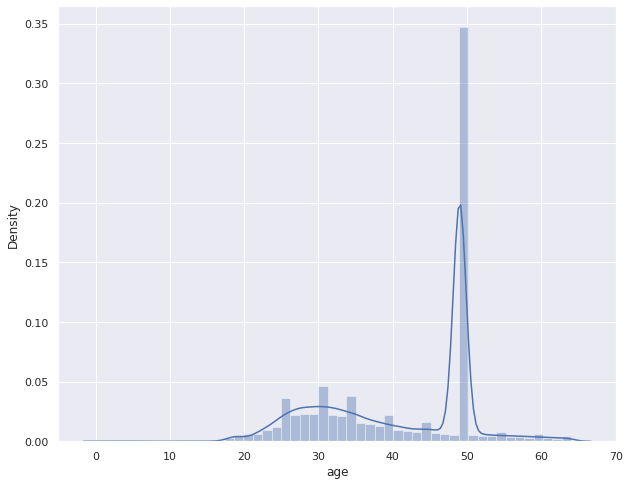

In [172]:
#Column Age

#data['age'].describe()

aux1 = data[data['age'].isna()]
print(aux1['country_destination'].value_counts(normalize=True))

data['age'] = data['age'].fillna(data['age'].mean()).astype(int)

plt.figure(figsize = (10,8 ))
sns.distplot(data[data['age'] < 65]['age'])


In [173]:
#first_affiliate_tracked

aux2 = data[data['first_affiliate_tracked'].isna()]
aux2['country_destination'].value_counts(normalize=True)

#Neste variavel temos apenas 3% de dados faltantes, neste caso por ser dados categoricos, prefiro jogar fora do que tentar substituir e acabar inputando um viés nos dados.

data = data[~data['first_affiliate_tracked'].isna()]

### sessions.csv (data1)

In [174]:
#user_id          0.003264
data_session = data_session[~data_session['user_id'].isna()]

#action           0.007535
data_session = data_session[~data_session['action'].isna()]

#action_type      0.106570
data_session = data_session[~data_session['action_type'].isna()]

#action_detail    0.106570
data_session = data_session[~data_session['action_detail'].isna()]

#device_type      0.000000
data_session = data_session[~data_session['device_type'].isna()]

#secs_elapsed     0.012872
data_session = data_session[~data_session['secs_elapsed'].isna()]

## Change data type

In [175]:
#date_account_created 
data['date_account_created'] = pd.to_datetime( data['date_account_created'] )

#timestamp_first_active
data['timestamp_first_active'] = pd.to_datetime(data['timestamp_first_active'], format='%Y%m%d%H%M%S')
data['timestamp_first_active'] = pd.to_datetime(data['timestamp_first_active'].dt.strftime('%y-%m-%d-'))

#date_first_booking
data['date_first_booking'] = pd.to_datetime(data['date_first_booking'])

#age
data['age'] = data['age'].astype(int)


In [176]:
data.dtypes

id                                 object
date_account_created       datetime64[ns]
timestamp_first_active     datetime64[ns]
date_first_booking         datetime64[ns]
gender                             object
age                                 int64
signup_method                      object
signup_flow                         int64
language                           object
affiliate_channel                  object
affiliate_provider                 object
first_affiliate_tracked            object
signup_app                         object
first_device_type                  object
first_browser                      object
country_destination                object
dtype: object

In [177]:
data.sample()

,id,date_account_created,timestamp_first_active,date_first_booking,gender,age,signup_method,signup_flow,language,affiliate_channel,affiliate_provider,first_affiliate_tracked,signup_app,first_device_type,first_browser,country_destination
49425,qst8oecoq1,2012-11-21,2021-12-11,2015-06-29,-unknown-,49,basic,0,en,direct,direct,untracked,Web,Windows Desktop,Chrome,NDF


### Check Balanced Data

In [178]:
data['country_destination'].value_counts(normalize=True)

NDF      0.579673
US       0.294461
other    0.048128
FR       0.023623
IT       0.013458
GB       0.011066
ES       0.010671
CA       0.006707
DE       0.005020
NL       0.003621
AU       0.002541
PT       0.001032
Name: country_destination, dtype: float64

Classe resposta bem desbalanceada, vamos seguir dessa forma para finalizarmos o pipeline com o primeiro ciclo de crisp

# 2.0 Descriptive Statistics

In [179]:
num_atributes = data.select_dtypes( include=['int64', 'float64'])
cat_atributes = data.select_dtypes( exclude=['int64', 'float64', 'datetime64[ns]'])

num_atributes_session = data_session.select_dtypes( include=['int64', 'float64'])
cat_atributes_session = data_session.select_dtypes( exclude=['int64', 'float64', 'datetime64[ns]'])

## 2.1 Numerical Atributes

In [180]:
# Data users
drescriptive_statistical(num_atributes)

,attributes,min,max,range,mean,median,std,skew,kurtosis
0,age,1.0,2014.0,2013.0,49.183142,49.0,118.421689,16.333820,267.655434
1,signup_flow,0.0,25.0,25.0,3.151490,0.0,7.543915,2.287158,3.567794


In [181]:
# Data Session
drescriptive_statistical(num_atributes_session)

,attributes,min,max,range,mean,median,std,skew,kurtosis
0,secs_elapsed,0.0,1799977.0,1799977.0,19961.8251,1369.0,88849.388449,11.137761,154.84312


## 2.2 Cat Atributes

In [182]:
cat_atributes.describe().T

,count,unique,top,freq
id,207386,207386,gxn3p5htnn,1
gender,207386,4,-unknown-,91783
signup_method,207386,3,basic,148297
language,207386,25,en,200415
affiliate_channel,207386,8,direct,134179
affiliate_provider,207386,18,direct,133935
first_affiliate_tracked,207386,7,untracked,109232
signup_app,207386,4,Web,178334
first_device_type,207386,9,Mac Desktop,89600
first_browser,207386,52,Chrome,63845


In [183]:
cat_atributes_session.describe().T

,count,unique,top,freq
user_id,9213930,133878,mxqbh3ykxl,2713
action,9213930,347,show,2178382
action_type,9213930,10,view,3545621
action_detail,9213930,155,view_search_results,1770931
device_type,9213930,14,Mac Desktop,3019523


# 3.0 Feature Engineering

In [184]:
data1 = data.copy()

data1.head(1)

,id,date_account_created,timestamp_first_active,date_first_booking,gender,age,signup_method,signup_flow,language,affiliate_channel,affiliate_provider,first_affiliate_tracked,signup_app,first_device_type,first_browser,country_destination
0,gxn3p5htnn,2010-06-28,2019-09-03,2015-06-29,-unknown-,49,facebook,0,en,direct,direct,untracked,Web,Mac Desktop,Chrome,NDF


## 3.1 Mapa Mental

## 3.2 Criação das Hipóteses

**H01.** Em todos os destinos, os usuarios levam 15 dias, em média, para fazer a primeira reserva no Airbnb, desde sua primeira ativação

**H02.** Em todos os destino, os usuarios levam 3 dias, em media, para fazer o cadastro no site.

**H03.** O volume de reserva anual feitas durante o verão aumentaram 20% para destinos dentro dos USA.

**H04.** Usuarios do sexo Feminino fazem 10% mais reservas para paises fora do EUA.

**H05.** O canal de marketing google representa 40% das reservas para paises fora dos EUA

**H06.** O Destino dos USA representam mais de 20% em todos os canais

**H07.** A idade media das pessoas é de 35 anos em todos os destinos.

**H08.** A porcentagem de usuarios que usam o site n linhgua ingles-americanos para reservar acomodações em qualquer destino é maior que 90%.

**H09.** O Número de reserva do Airbnb é crescente ou decrescente ao longo dos anos

**H10.** O numero de reservas do Airbnb é crescente ao longo dos anos.

## 3.3 Derivação de Novas Features

In [185]:
#Days from fisrt active up to first booking
data1['days_from _first_active_until_booking'] = (data1['date_first_booking'] - data1['timestamp_first_active']).apply(lambda x: x.days)
data1['days_from _first_active_until_booking'] = (data1['days_from _first_active_until_booking']).apply(lambda x: 0 if x < 0 else x)

#Days from first active upt to account created
data1['days_from _first_active_until_account_created'] = (data1['timestamp_first_active'] - data1['date_account_created']).apply(lambda x: x.days)
data1['days_from _first_active_until_account_created'] = (data1['days_from _first_active_until_account_created']).apply(lambda x: 0 if x < 0 else x )

#Days from account created up to first boooking
data1['days_from _account_created_until_booking'] = (data1['date_first_booking'] - data1['date_account_created']).apply(lambda x: x.days)
data1['days_from _account_created_until_booking'] = (data1['days_from _account_created_until_booking']).apply(lambda x: 0 if x < 0 else x)

#year
data1['date_account_created_year'] = data1['date_account_created'].dt.year
data1['timestamp_first_active_year'] = data1['timestamp_first_active'].dt.year
data1['date_first_booking_year'] = data1['date_first_booking'].dt.year

#month
data1['date_account_created_month'] = data1['date_account_created'].dt.month
data1['timestamp_first_active_month'] = data1['timestamp_first_active'].dt.month
data1['date_first_booking_month'] = data1['date_first_booking'].dt.month

#week
data1['date_account_created_week'] = data1['date_account_created'].dt.weekday
data1['timestamp_first_active_week'] = data1['timestamp_first_active'].dt.weekday
data1['date_first_booking_week'] = data1['date_first_booking'].dt.weekday

#days
data1['date_account_created_day'] = data1['date_account_created'].dt.day
data1['timestamp_first_active_day'] = data1['timestamp_first_active'].dt.day
data1['date_first_booking_day'] = data1['date_first_booking'].dt.day


In [186]:
data1.head()

,id,date_account_created,timestamp_first_active,date_first_booking,gender,age,signup_method,signup_flow,language,affiliate_channel,...,date_first_booking_year,date_account_created_month,timestamp_first_active_month,date_first_booking_month,date_account_created_week,timestamp_first_active_week,date_first_booking_week,date_account_created_day,timestamp_first_active_day,date_first_booking_day
0,gxn3p5htnn,2010-06-28,2019-09-03,2015-06-29,-unknown-,49,facebook,0,en,direct,...,2015,6,9,6,0,1,0,28,3,29
1,820tgsjxq7,2011-05-25,2023-09-05,2015-06-29,MALE,38,facebook,0,en,seo,...,2015,5,9,6,2,1,0,25,5,29
2,4ft3gnwmtx,2010-09-28,2009-09-06,2010-08-02,FEMALE,56,basic,3,en,direct,...,2010,9,9,8,1,6,0,28,6,2
3,bjjt8pjhuk,2011-12-05,2031-09-10,2012-09-08,FEMALE,42,facebook,0,en,direct,...,2012,12,9,9,0,2,5,5,10,8
4,87mebub9p4,2010-09-14,2008-09-12,2010-02-18,-unknown-,41,basic,0,en,direct,...,2010,9,9,2,1,4,3,14,12,18


# 4.0 Data Filtering

In [187]:
data2 = data1.copy()

## 4.1 Filtering Rows

### Date Users

### Age

<AxesSubplot:xlabel='age', ylabel='Density'>

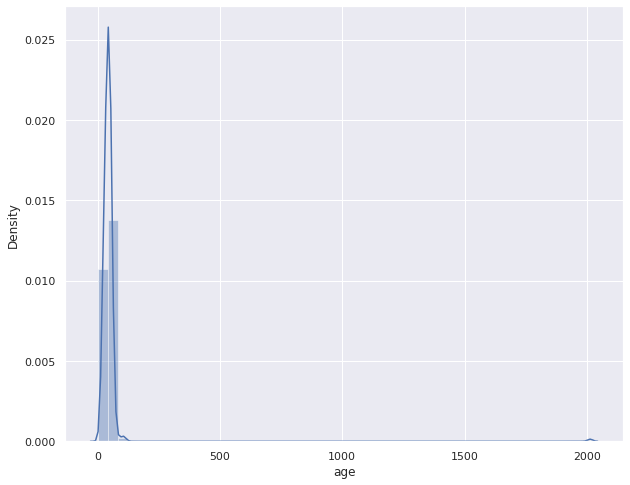

In [188]:
plt.figure(figsize = (10,8 ))
sns.distplot(data2['age']) 

<AxesSubplot:xlabel='age'>

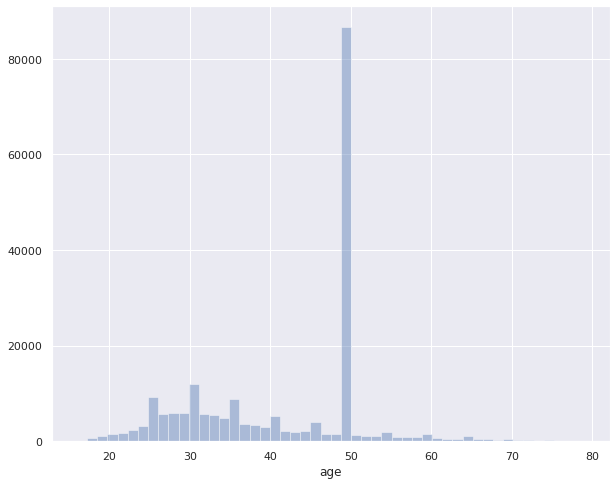

In [189]:
age_aux = data2[(data2['age'] > 15) & (data2['age'] < 80)]

plt.figure(figsize = (10,8 ))
sns.distplot(age_aux['age'], kde=False) 

In [190]:
#Verificando as pessoas com idade > 80 em relação a variavel resposta
age_aux1 = data2[data2['age'] > 80][['age', 'country_destination']]
age_aux1.groupby('country_destination').size() / len(aux)

#Analisando os clientes com mais de 80 anos, podemos notar que existe uma distribuição desbalanceada entre as classes. Lembrando que todos os nossos dados esta com este
#mesmo desbalanceamento. Neste caso faz algum sentido essas idades em nossos dados e vamos assumir que clientes acima de 15 e abaixo de 120 esteja corretos em nossos dados. 
#Importante na decisão de corte de dados seria manter as mesmas proporções entre as classes, para criarmos vies ao modelo.

country_destination
AU       0.000064
CA       0.000185
DE       0.000136
ES       0.000257
FR       0.000514
GB       0.000337
IT       0.000458
NDF      0.010149
NL       0.000104
PT       0.000016
US       0.008061
other    0.001477
dtype: float64

<AxesSubplot:xlabel='age'>

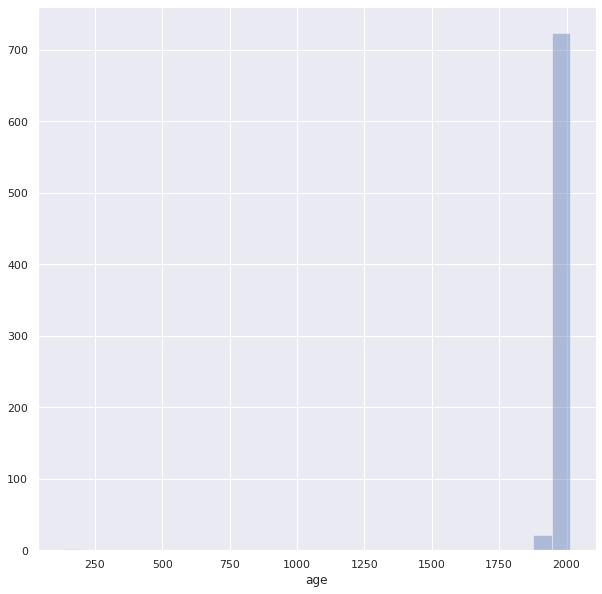

In [191]:
sns.distplot(data2[data2['age'] > 120]['age'], kde=False) 

<AxesSubplot:xlabel='age'>

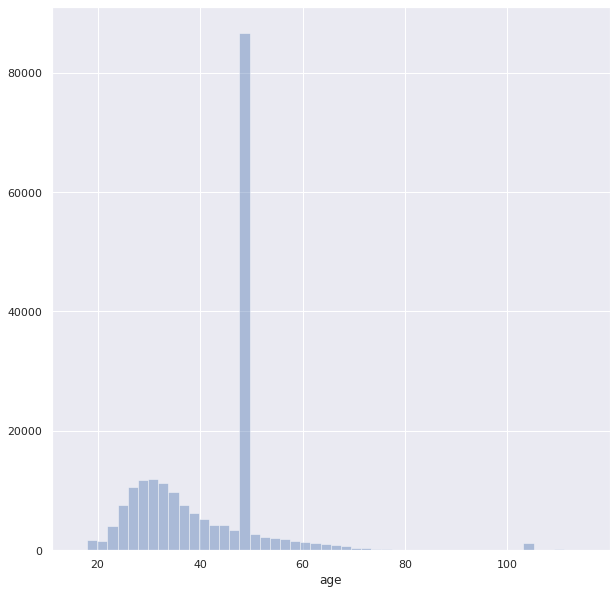

In [192]:
# Filtering rows:
# age - greater than 15 and lower that 120 - There are few people over 120 years old.

data2 = data2[(data2['age'] > 15 ) & (data2['age'] < 120)]
data2['age'] = data2['age'].fillna(data2['age'].mean()).astype(int)

sns.distplot(data2['age'], kde=False) 

### Filtering Rows - Date Session

In [193]:
# secs_elapsed

#Essa feature nos tras as informações de quanto tempo o cliente permaneceu no site, estranhamente temos tempo = 0

data_session = data_session[data_session['secs_elapsed'] > 0]

## 4.2 Cat_atributes

### Data User

In [194]:
from pandas_profiling import ProfileReport

profile = ProfileReport(cat_atributes)

In [195]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [196]:
cat_atributes.describe().T

,count,unique,top,freq
id,207386,207386,gxn3p5htnn,1
gender,207386,4,-unknown-,91783
signup_method,207386,3,basic,148297
language,207386,25,en,200415
affiliate_channel,207386,8,direct,134179
affiliate_provider,207386,18,direct,133935
first_affiliate_tracked,207386,7,untracked,109232
signup_app,207386,4,Web,178334
first_device_type,207386,9,Mac Desktop,89600
first_browser,207386,52,Chrome,63845


In [197]:
a1  = cramer_v(cat_atributes['gender'], cat_atributes['gender'])
a2  = cramer_v(cat_atributes['gender'], cat_atributes['signup_method'])
a3  = cramer_v(cat_atributes['gender'], cat_atributes['language'])
a4  = cramer_v(cat_atributes['gender'], cat_atributes['affiliate_channel'])
a5  = cramer_v(cat_atributes['gender'], cat_atributes['affiliate_provider'])
a6  = cramer_v(cat_atributes['gender'], cat_atributes['first_affiliate_tracked'])
a7  = cramer_v(cat_atributes['gender'], cat_atributes['signup_app'])
a8  = cramer_v(cat_atributes['gender'], cat_atributes['first_device_type'])
a9  = cramer_v(cat_atributes['gender'], cat_atributes['first_browser'])
a10 = cramer_v(cat_atributes['gender'], cat_atributes['country_destination'])

b1  = cramer_v(cat_atributes['signup_method'], cat_atributes['gender'])
b2  = cramer_v(cat_atributes['signup_method'], cat_atributes['signup_method'])
b3  = cramer_v(cat_atributes['signup_method'], cat_atributes['language'])
b4  = cramer_v(cat_atributes['signup_method'], cat_atributes['affiliate_channel'])
b5  = cramer_v(cat_atributes['signup_method'], cat_atributes['affiliate_provider'])
b6  = cramer_v(cat_atributes['signup_method'], cat_atributes['first_affiliate_tracked'])
b7  = cramer_v(cat_atributes['signup_method'], cat_atributes['signup_app'])
b8  = cramer_v(cat_atributes['signup_method'], cat_atributes['first_device_type'])
b9  = cramer_v(cat_atributes['signup_method'], cat_atributes['first_browser'])
b10 = cramer_v(cat_atributes['signup_method'], cat_atributes['country_destination'])

c1  = cramer_v(cat_atributes['language'], cat_atributes['gender'])
c2  = cramer_v(cat_atributes['language'], cat_atributes['signup_method'])
c3  = cramer_v(cat_atributes['language'], cat_atributes['language'])
c4  = cramer_v(cat_atributes['language'], cat_atributes['affiliate_channel'])
c5  = cramer_v(cat_atributes['language'], cat_atributes['affiliate_provider'])
c6  = cramer_v(cat_atributes['language'], cat_atributes['first_affiliate_tracked'])
c7  = cramer_v(cat_atributes['language'], cat_atributes['signup_app'])
c8  = cramer_v(cat_atributes['language'], cat_atributes['first_device_type'])
c9  = cramer_v(cat_atributes['language'], cat_atributes['first_browser'])
c10 = cramer_v(cat_atributes['language'], cat_atributes['country_destination'])

d1  = cramer_v(cat_atributes['affiliate_channel'], cat_atributes['gender'])
d2  = cramer_v(cat_atributes['affiliate_channel'], cat_atributes['signup_method'])
d3  = cramer_v(cat_atributes['affiliate_channel'], cat_atributes['language'])
d4  = cramer_v(cat_atributes['affiliate_channel'], cat_atributes['affiliate_channel'])
d5  = cramer_v(cat_atributes['affiliate_channel'], cat_atributes['affiliate_provider'])
d6  = cramer_v(cat_atributes['affiliate_channel'], cat_atributes['first_affiliate_tracked'])
d7  = cramer_v(cat_atributes['affiliate_channel'], cat_atributes['signup_app'])
d8  = cramer_v(cat_atributes['affiliate_channel'], cat_atributes['first_device_type'])
d9  = cramer_v(cat_atributes['affiliate_channel'], cat_atributes['first_browser'])
d10 = cramer_v(cat_atributes['affiliate_channel'], cat_atributes['country_destination'])

e1  = cramer_v(cat_atributes['affiliate_provider'], cat_atributes['gender'])
e2  = cramer_v(cat_atributes['affiliate_provider'], cat_atributes['signup_method'])
e3  = cramer_v(cat_atributes['affiliate_provider'], cat_atributes['language'])
e4  = cramer_v(cat_atributes['affiliate_provider'], cat_atributes['affiliate_channel'])
e5  = cramer_v(cat_atributes['affiliate_provider'], cat_atributes['affiliate_provider'])
e6  = cramer_v(cat_atributes['affiliate_provider'], cat_atributes['first_affiliate_tracked'])
e7  = cramer_v(cat_atributes['affiliate_provider'], cat_atributes['signup_app'])
e8  = cramer_v(cat_atributes['affiliate_provider'], cat_atributes['first_device_type'])
e9  = cramer_v(cat_atributes['affiliate_provider'], cat_atributes['first_browser'])
e10 = cramer_v(cat_atributes['affiliate_provider'], cat_atributes['country_destination'])

f1  = cramer_v(cat_atributes['first_affiliate_tracked'], cat_atributes['gender'])
f2  = cramer_v(cat_atributes['first_affiliate_tracked'], cat_atributes['signup_method'])
f3  = cramer_v(cat_atributes['first_affiliate_tracked'], cat_atributes['language'])
f4  = cramer_v(cat_atributes['first_affiliate_tracked'], cat_atributes['affiliate_channel'])
f5  = cramer_v(cat_atributes['first_affiliate_tracked'], cat_atributes['affiliate_provider'])
f6  = cramer_v(cat_atributes['first_affiliate_tracked'], cat_atributes['first_affiliate_tracked'])
f7  = cramer_v(cat_atributes['first_affiliate_tracked'], cat_atributes['signup_app'])
f8  = cramer_v(cat_atributes['first_affiliate_tracked'], cat_atributes['first_device_type'])
f9  = cramer_v(cat_atributes['first_affiliate_tracked'], cat_atributes['first_browser'])
f10 = cramer_v(cat_atributes['first_affiliate_tracked'], cat_atributes['country_destination'])

g1  = cramer_v(cat_atributes['signup_app'], cat_atributes['gender'])
g2  = cramer_v(cat_atributes['signup_app'], cat_atributes['signup_method'])
g3  = cramer_v(cat_atributes['signup_app'], cat_atributes['language'])
g4  = cramer_v(cat_atributes['signup_app'], cat_atributes['affiliate_channel'])
g5  = cramer_v(cat_atributes['signup_app'], cat_atributes['affiliate_provider'])
g6  = cramer_v(cat_atributes['signup_app'], cat_atributes['first_affiliate_tracked'])
g7  = cramer_v(cat_atributes['signup_app'], cat_atributes['signup_app'])
g8  = cramer_v(cat_atributes['signup_app'], cat_atributes['first_device_type'])
g9  = cramer_v(cat_atributes['signup_app'], cat_atributes['first_browser'])
g10 = cramer_v(cat_atributes['signup_app'], cat_atributes['country_destination'])

h1  = cramer_v(cat_atributes['first_device_type'], cat_atributes['gender'])
h2  = cramer_v(cat_atributes['first_device_type'], cat_atributes['signup_method'])
h3  = cramer_v(cat_atributes['first_device_type'], cat_atributes['language'])
h4  = cramer_v(cat_atributes['first_device_type'], cat_atributes['affiliate_channel'])
h5  = cramer_v(cat_atributes['first_device_type'], cat_atributes['affiliate_provider'])
h6  = cramer_v(cat_atributes['first_device_type'], cat_atributes['first_affiliate_tracked'])
h7  = cramer_v(cat_atributes['first_device_type'], cat_atributes['signup_app'])
h8  = cramer_v(cat_atributes['first_device_type'], cat_atributes['first_device_type'])
h9  = cramer_v(cat_atributes['first_device_type'], cat_atributes['first_browser'])
h10 = cramer_v(cat_atributes['first_device_type'], cat_atributes['country_destination'])

i1  = cramer_v(cat_atributes['first_browser'], cat_atributes['gender'])
i2  = cramer_v(cat_atributes['first_browser'], cat_atributes['signup_method'])
i3  = cramer_v(cat_atributes['first_browser'], cat_atributes['language'])
i4  = cramer_v(cat_atributes['first_browser'], cat_atributes['affiliate_channel'])
i5  = cramer_v(cat_atributes['first_browser'], cat_atributes['affiliate_provider'])
i6  = cramer_v(cat_atributes['first_browser'], cat_atributes['first_affiliate_tracked'])
i7  = cramer_v(cat_atributes['first_browser'], cat_atributes['signup_app'])
i8  = cramer_v(cat_atributes['first_browser'], cat_atributes['first_device_type'])
i9  = cramer_v(cat_atributes['first_browser'], cat_atributes['first_browser'])
i10 = cramer_v(cat_atributes['first_browser'], cat_atributes['country_destination'])

j1  = cramer_v(cat_atributes['country_destination'], cat_atributes['gender'])
j2  = cramer_v(cat_atributes['country_destination'], cat_atributes['signup_method'])
j3  = cramer_v(cat_atributes['country_destination'], cat_atributes['language'])
j4  = cramer_v(cat_atributes['country_destination'], cat_atributes['affiliate_channel'])
j5  = cramer_v(cat_atributes['country_destination'], cat_atributes['affiliate_provider'])
j6  = cramer_v(cat_atributes['country_destination'], cat_atributes['first_affiliate_tracked'])
j7  = cramer_v(cat_atributes['country_destination'], cat_atributes['signup_app'])
j8  = cramer_v(cat_atributes['country_destination'], cat_atributes['first_device_type'])
j9  = cramer_v(cat_atributes['country_destination'], cat_atributes['first_browser'])
j10 = cramer_v(cat_atributes['country_destination'], cat_atributes['country_destination'])




In [198]:
d = pd.DataFrame({  'gender':[a1,a2,a3,a4,a5,a6,a7,a8,a9,a10]
                    ,'signup_method':[b1,b2,b3,b4,b5,b6,b7,b8,b9,b10]
                    ,'language':[c1,c2,c3,c4,c5,c6,c7,c8,c9,c10]
                    ,'affiliate_channel':[d1,d2,d3,d4,d5,d6,d7,d8,d9,d10]
                    ,'affiliate_provider':[e1,e2,e3,e4,e5,e6,e7,e8,e9,e10]
                    ,'first_affiliate_tracked':[f1,f2,f3,f4,f5,f6,f7,f8,f9,f10]
                    ,'signup_app':[g1,g2,g3,g4,g5,g6,g7,g8,g9,g10]
                    ,'first_device_type':[h1,h2,h3,h4,h5,h6,h7,h8,h9,h10]
                    ,'first_browser':[i1,i2,i3,i4,i5,i6,i7,i8,i9,i10]
                    ,'country_destination':[j1,j2,j3,j4,j5,j6,j7,j8,j9,j10]})

d = d.set_index(d.columns)

<AxesSubplot:>

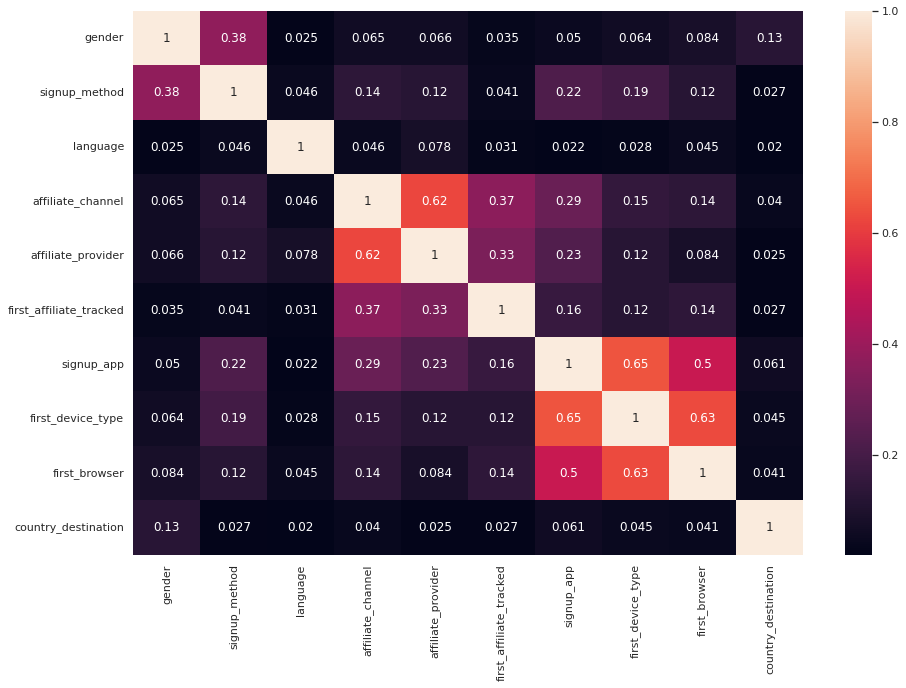

In [199]:
sns.set(rc= {'figure.figsize': (15,10)})
sns.heatmap(d, annot=True)

### Data Session

In [200]:
cat_atributes_session.describe().T

,count,unique,top,freq
user_id,9213930,133878,mxqbh3ykxl,2713
action,9213930,347,show,2178382
action_type,9213930,10,view,3545621
action_detail,9213930,155,view_search_results,1770931
device_type,9213930,14,Mac Desktop,3019523


In [201]:
l1  = cramer_v(cat_atributes_session['action'], cat_atributes_session['action'])
l2  = cramer_v(cat_atributes_session['action'], cat_atributes_session['action_type'])
l3  = cramer_v(cat_atributes_session['action'], cat_atributes_session['action_detail'])
l4  = cramer_v(cat_atributes_session['action'], cat_atributes_session['device_type'])

m1  = cramer_v(cat_atributes_session['action_type'], cat_atributes_session['action'])
m2  = cramer_v(cat_atributes_session['action_type'], cat_atributes_session['action_type'])
m3  = cramer_v(cat_atributes_session['action_type'], cat_atributes_session['action_detail'])
m4  = cramer_v(cat_atributes_session['action_type'], cat_atributes_session['device_type'])

n1  = cramer_v(cat_atributes_session['action_detail'], cat_atributes_session['action'])
n2  = cramer_v(cat_atributes_session['action_detail'], cat_atributes_session['action_type'])
n3  = cramer_v(cat_atributes_session['action_detail'], cat_atributes_session['action_detail'])
n4  = cramer_v(cat_atributes_session['action_detail'], cat_atributes_session['device_type'])

o1  = cramer_v(cat_atributes_session['device_type'], cat_atributes_session['action'])
o2  = cramer_v(cat_atributes_session['device_type'], cat_atributes_session['action_type'])
o3  = cramer_v(cat_atributes_session['device_type'], cat_atributes_session['action_detail'])
o4  = cramer_v(cat_atributes_session['device_type'], cat_atributes_session['device_type'])

In [202]:
cat = pd.DataFrame({'action': [l1, l2, l3, l4]
                ,'action_type': [m1,m2,m3,m4]
                ,'action_detail': [n1,n2,n3,n4]
                ,'device_type': [o1,o2,o3,o4]
})

cat= cat.set_index(cat.columns)

<AxesSubplot:>

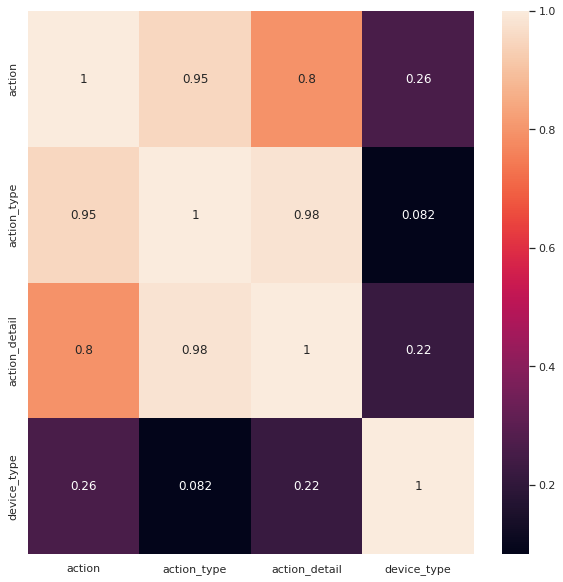

In [203]:
sns.set(rc= {'figure.figsize': (10,10)})
sns.heatmap(cat, annot=True)

# 5.0 Balanced Dataset

Não precisei balancear os dados neste ciclo, pois os mesmos ja foram balanceados no ciclo 5.

In [6]:
#Dados balanceado no ciclo anterior
data_balanced = pd.read_csv(path_data+'ciclo005_balanced_dataset.csv')

In [7]:
data_balanced.head()

,gender,signup_method,language,affiliate_channel,affiliate_provider,first_affiliate_tracked,signup_app,first_device_type,first_browser,age,...,date_account_created_month,timestamp_first_active_month,date_first_booking_month,date_account_created_week,timestamp_first_active_week,date_first_booking_week,date_account_created_day,timestamp_first_active_day,date_first_booking_day,country_destination
0,-unknown-,facebook,en,direct,direct,untracked,Web,Mac Desktop,Chrome,49,...,6,9,6,0,1,0,28,3,29,NDF
1,MALE,facebook,en,seo,google,untracked,Web,Mac Desktop,Chrome,38,...,5,9,6,2,1,0,25,5,29,NDF
2,FEMALE,basic,en,direct,direct,untracked,Web,Windows Desktop,IE,56,...,9,9,8,1,6,0,28,6,2,US
3,FEMALE,facebook,en,direct,direct,untracked,Web,Mac Desktop,Firefox,42,...,12,9,9,0,2,5,5,10,8,other
4,-unknown-,basic,en,direct,direct,untracked,Web,Mac Desktop,Chrome,41,...,9,9,2,1,4,3,14,12,18,US


# 6.0 Exploratory data analysis

In [204]:
data3 = data2.copy()

## 6.1 Univariate Analysis - Feature Behaviour (Balanced Dataset)

In [221]:
from pandas_profiling import ProfileReport

profile = ProfileReport(data_balanced)

In [206]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## 6.2 Bivariate Analysis - Hypothesis Validation (Unbalanced Dataset)

In [222]:
data3.head(1)

,id,date_account_created,timestamp_first_active,date_first_booking,gender,age,signup_method,signup_flow,language,affiliate_channel,...,date_first_booking_year,date_account_created_month,timestamp_first_active_month,date_first_booking_month,date_account_created_week,timestamp_first_active_week,date_first_booking_week,date_account_created_day,timestamp_first_active_day,date_first_booking_day
0,gxn3p5htnn,2010-06-28,2019-09-03,2015-06-29,-unknown-,49,facebook,0,en,direct,...,2015,6,9,6,0,1,0,28,3,29


**H01.** Em todos os destinos, os usuarios levam 15 dias, em média, para fazer a primeira reserva no Airbnb, desde sua primeira ativação

**H02.** Em todos os destino, os usuarios levam 3 dias, em media, para fazer o cadastro no site.

**H03.** O volume de reserva anual feitas durante o verão aumentaram 20% para destinos dentro dos USA.

**H04.** Usuarios do sexo Feminino fazem 10% mais reservas para paises fora do EUA.

**H05.** O canal de marketing google representa 40% das reservas para paises fora dos EUA

**H06.** O Destino dos USA representam mais de 20% em todos os canais

**H07.** A idade media das pessoas é de 35 anos em todos os destinos.

**H08.** A porcentagem de usuarios que usam o site n linhgua ingles-americanos para reservar acomodações em qualquer destino é maior que 90%.

**H09.** O Número de reserva do Airbnb é crescente ou decrescente ao longo dos anos

**H10.** O numero de reservas do Airbnb é crescente ao longo dos anos.

# 7.0 Data Preparation

In [8]:
data4 = data_balanced.copy()

In [9]:
data4.country_destination.value_counts()

US       121057
NDF      119810
FR       116846
IT       110848
other    108793
GB       102656
ES        98982
CA        98204
DE        98051
NL        96923
AU        94631
PT        93716
Name: country_destination, dtype: int64

## 7.1 Columns Selection

In [10]:
#High Correlation

#Dataset session
#coldrop_session = ['action', 'action_detail'] #Hight Correlation
#data_session = data_session.drop(coldrop_session, axis=1)

#dataser User

#data_drop = ['id', 'date_account_created', 'timestamp_first_active', 'date_first_booking', #original datetime
data_drop = ['days_from _first_active_until_booking', 'affiliate_provider','first_device_type', 'first_browser','language']

data4 = data4.drop(data_drop, axis=1)

In [11]:
data4.dtypes

gender                                           object
signup_method                                    object
affiliate_channel                                object
first_affiliate_tracked                          object
signup_app                                       object
age                                               int64
signup_flow                                       int64
days_from _first_active_until_account_created     int64
days_from _account_created_until_booking          int64
date_account_created_year                         int64
timestamp_first_active_year                       int64
date_first_booking_year                           int64
date_account_created_month                        int64
timestamp_first_active_month                      int64
date_first_booking_month                          int64
date_account_created_week                         int64
timestamp_first_active_week                       int64
date_first_booking_week                         

In [12]:
data4.head(1)

,gender,signup_method,affiliate_channel,first_affiliate_tracked,signup_app,age,signup_flow,days_from _first_active_until_account_created,days_from _account_created_until_booking,date_account_created_year,...,date_account_created_month,timestamp_first_active_month,date_first_booking_month,date_account_created_week,timestamp_first_active_week,date_first_booking_week,date_account_created_day,timestamp_first_active_day,date_first_booking_day,country_destination
0,-unknown-,facebook,direct,untracked,Web,49,0,3354,1827,2010,...,6,9,6,0,1,0,28,3,29,NDF


## 7.2 Rescaling

In [13]:
ss = pp.StandardScaler()
rb = RobustScaler()
mms= pp.MinMaxScaler()

                                
# age - Standartization
data4['age'] = ss.fit_transform(data4[['age']].values)
  
# signup_flow - Robust Scaler                    
data4['signup_flow'] = rb.fit_transform(data4[['signup_flow']].values)

# days_from _first_active_until_account_created - Robust Scaler
data4['days_from _first_active_until_account_created'] = rb.fit_transform(data4[['days_from _first_active_until_account_created']].values)

# days_from _account_created_until_booking - Robust Scaler  
data4['days_from _account_created_until_booking'] = rb.fit_transform(data4[['days_from _account_created_until_booking']].values)

# date_account_created_year - MinMax Scaler
data4['date_account_created_year'] = mms.fit_transform(data4[['date_account_created_year']].values)

# timestamp_first_active_year - MinMax Scaler     
data4['timestamp_first_active_year'] = mms.fit_transform(data4[['timestamp_first_active_year']].values)

# date_first_booking_year - MinMax Scaler   
data4['date_first_booking_year'] = mms.fit_transform(data4[['date_first_booking_year']].values)

# date_account_created_month - MinMax Scaler       
data4['date_account_created_month'] = mms.fit_transform(data4[['date_account_created_month']].values)


# timestamp_first_active_month - MinMax Scaler     
data4['timestamp_first_active_month'] = mms.fit_transform(data4[['timestamp_first_active_month']].values)

  
# date_first_booking_month - MinMax Scaler                      
data4['date_first_booking_month'] = mms.fit_transform(data4[['date_first_booking_month']].values)
                                      
                      

## 7.3 Encoder

In [14]:
te = TargetEncoder()

# gender - One hot encoding
data4 = pd.get_dummies( data4, prefix=['gender'], columns=['gender'])

# signup_method - One hot encoding
data4 = pd.get_dummies( data4, prefix=['signup_method'], columns=['signup_method'])

# signup_app - One hot encoding
data4 = pd.get_dummies( data4, prefix=['signup_app'], columns=['signup_app'])

#Target enconder so aceita variavel resposta como numero, neste caso vamos precisar modificar para que possamos conseguir fazer essa transformação.
c = {'NDF':0, 'US':1, 'other':2, 'CA':3, 'FR':4, 'ES':5, 'GB':6, 'IT':7, 'PT':8, 'NL':9, 'DE':10, 'AU':11}

# affiliate_channel - Target Encoding
data4['affiliate_channel'] = te.fit_transform(data4[['affiliate_channel']].values, data4['country_destination'].map(c))

# first_affiliate_tracked - Target Encoding
data4['first_affiliate_tracked'] = te.fit_transform(data4[['first_affiliate_tracked']].values, data4['country_destination'].map(c))

## 7.4 Transformation

In [15]:
# date_first_booking_day - Transformação de Natureza

# date_first_booking_week - Transformação de Natureza 
data4['date_first_booking_week_sin'] = data4['date_first_booking_week'].apply(lambda x: np.sin(x * (2*np.pi/7))) # 7 significa o tempo, temos 7 dia 1 semanas e depois elas se repetem.
data4['date_first_booking_week_cos'] = data4['date_first_booking_week'].apply(lambda x: np.cos(x * (2*np.pi/7)))

# date_account_created_day - Transformação de Natureza 
data4['date_account_created_day_sin'] = data4['date_account_created_day'].apply(lambda x: np.sin(x * (2*np.pi/31))) # 31 significa o tempo, temos 31 dias e depois se repete
data4['date_account_created_day_cos'] = data4['date_account_created_day'].apply(lambda x: np.cos(x * (2*np.pi/31)))

# date_account_created_week - Transformação de Natureza 
data4['date_account_created_week_sin'] = data4['date_account_created_week'].apply(lambda x: np.sin(x * (2*np.pi/7))) # 7 significa o tempo, temos 7 dias 1 semanas e depois elas se repetem.
data4['date_account_created_week_cos'] = data4['date_account_created_week'].apply(lambda x: np.cos(x * (2*np.pi/7)))

                     
# timestamp_first_active_week - Transformação de Natureza 
data4['timestamp_first_active_week_sin'] = data4['timestamp_first_active_week'].apply(lambda x: np.sin(x * (2*np.pi/7))) # 7 significa o tempo, temos 7 dias 1 semanas e depois elas se repetem.
data4['timestamp_first_active_week_cos'] = data4['timestamp_first_active_week'].apply(lambda x: np.cos(x * (2*np.pi/7)))
                   
# date_first_booking_week  - Transformação de Natureza 
data4['date_first_booking_week_sin'] = data4['date_first_booking_week'].apply(lambda x: np.sin(x * (2*np.pi/7))) # 7 significa o tempo, temos 7 dias 1 semanas e depois elas se repetem.
data4['date_first_booking_week_cos'] = data4['date_first_booking_week'].apply(lambda x: np.cos(x * (2*np.pi/7)))


# timestamp_first_active_day 
data4['timestamp_first_active_day_sin'] = data4['timestamp_first_active_day'].apply(lambda x: np.sin(x * (2*np.pi/31))) # 31 significa o tempo, temos 31 dias e depois se repete
data4['timestamp_first_active_day_cos'] = data4['timestamp_first_active_day'].apply(lambda x: np.cos(x * (2*np.pi/31)))


# 8.0 Feature Selection

In [26]:
data4.to_csv(path_data+'ciclo006_feature_selection_dataset.csv', index=False)

In [16]:
X = data4.drop('country_destination', axis=1)
y = data4['country_destination'].copy()

In [17]:
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=32)

In [18]:
ohe = pp.OneHotEncoder()

y_train_nn = ohe.fit_transform( y_train.values.reshape( -1, 1)).toarray()

# 9.0 Machine Learning Model

### Baseline Model

In [19]:
country_destination_list = data4['country_destination'].drop_duplicates().sort_values().tolist()
k_num = y_val.shape[0]
country_destination_weights = data4['country_destination'].value_counts( normalize=True).sort_index().tolist()

#Modelo Aleatório
yhat_random = random.choices( population=country_destination_list, k=k_num, weights=country_destination_weights)

Accuracy: 0.08402484688858566
Balanced Accuracy: 0.08333602747125689
Kappa Score: 4.389470338206358e-06


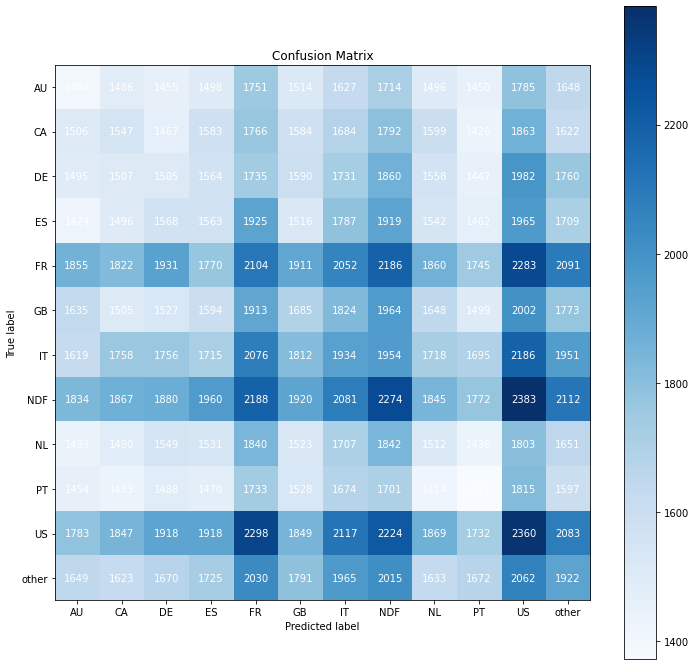

In [20]:
#Accuracy
acc_random = m.accuracy_score(y_val, yhat_random)
print('Accuracy: {}'.format(acc_random))

#Confusion Matrix
mt.plot_confusion_matrix( y_val, yhat_random, normalize= False, figsize=(12,12))

#Balanced Accuracy
balanced_accuracy_random = m.balanced_accuracy_score(y_val, yhat_random )
print('Balanced Accuracy: {}'.format(balanced_accuracy_random))

#Kappa Metrics
kappa_score_random = m.cohen_kappa_score(y_val, yhat_random)
print('Kappa Score: {}'.format(kappa_score_random))

#Objetivo é aumentar o Balanced Accuracy para uns 85% (Acuracia para apresentar ao time de negocio
#Kappa Score uns 75% (Nivel de concordancia entre as classes).

#print(m.classification_report(y_val_nn, yhat_nn))

### Neural Network MLP

In [21]:
##Model Definition
model = ml.Sequential()
#
model.add( l.Dense(128, input_dim=X_train.shape[1], activation= 'relu'))
model.add( l.Dense( 12, activation = 'softmax'))
#
#model Compile
model.compile( loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

#Train model
model.fit( X_train, y_train_nn, epochs=100)

2022-12-15 08:23:21.680827: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-12-15 08:23:21.680988: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2022-12-15 08:23:21.681036: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcublas.so.11'; dlerror: libcublas.so.11: cannot open shared object file: No such file or directory
2022-12-15 08:23:21.681078: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcublasLt.so.11'; dlerror: libcublasLt.so.11: cannot open shared object file: No such file or directory
2022-12-15 08:23:21.681135: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Co

Epoch 1/100
31513/31513 [==============================] - 17s 544us/step - loss: 2.0288 - accuracy: 0.2745
Epoch 2/100
31513/31513 [==============================] - 17s 544us/step - loss: 1.9198 - accuracy: 0.3167
Epoch 3/100
31513/31513 [==============================] - 17s 543us/step - loss: 1.8869 - accuracy: 0.3277
Epoch 4/100
31513/31513 [==============================] - 17s 544us/step - loss: 1.8705 - accuracy: 0.3342
Epoch 5/100
31513/31513 [==============================] - 17s 545us/step - loss: 1.8584 - accuracy: 0.3385
Epoch 6/100
31513/31513 [==============================] - 17s 548us/step - loss: 1.8491 - accuracy: 0.3420
Epoch 7/100
31513/31513 [==============================] - 17s 544us/step - loss: 1.8424 - accuracy: 0.3445
Epoch 8/100
31513/31513 [==============================] - 17s 546us/step - loss: 1.8370 - accuracy: 0.3463
Epoch 9/100
31513/31513 [==============================] - 17s 543us/step - loss: 1.8322 - accuracy: 0.3478
Epoch 10/100
31513/31513 [==

In [23]:
#Salvando o treinamento em um arquico compactado
pickle.dump(model, open(path_model+'ciclo006_model_NLP.pkl', 'wb'))

INFO:tensorflow:Assets written to: ram://f7f73806-c12e-45ba-89f4-ad6bbcc8a5b4/assets


In [24]:
model = pickle.load(open(path_model+'ciclo005_model_NLP.pkl', 'rb'))

#Prediction
pred_nn = model.predict(X_val)

#Invert prediction
yhat_nn = ohe.inverse_transform(pred_nn)

#Prediction prepare
y_val_nn = y_val.to_numpy()
yhat_nn = yhat_nn.reshape(1, -1)[0]

7879/7879 [==============================] - 3s 416us/step


Accuracy: 0.36651540634024055
Balanced Accuracy: 0.36551124461211965
Kappa Score: 0.30851011295822783


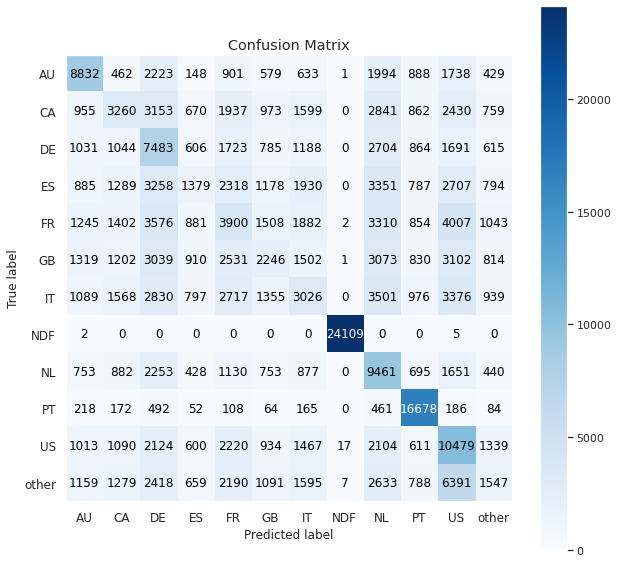

In [245]:
#Accuracy
acc_nn = m.accuracy_score(y_val_nn, yhat_nn)
print('Accuracy: {}'.format(acc_nn))

#Confusion Matrix
mt.plot_confusion_matrix( y_val_nn, yhat_nn, normalize= False, figsize=(10,10))

#Balanced Accuracy
balanced_accuracy = m.balanced_accuracy_score(y_val_nn, yhat_nn )
print('Balanced Accuracy: {}'.format(balanced_accuracy))

#Kappa Metrics
kappa_score = m.cohen_kappa_score(y_val_nn, yhat_nn)
print('Kappa Score: {}'.format(kappa_score))

#Objetivo é aumentar o Balanced Accuracy para uns 85% (Acuracia para apresentar ao time de negocio
#Kappa Score uns 75% (Nivel de concordancia entre as classes).

#print(m.classification_report(y_val_nn, yhat_nn))